In [5]:
from IPython.display import HTML

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<style>
.output_png {
    display: table-cell;
    text-align: center;
    horizontal-align: middle;
    vertical-align: middle;
    margin:auto;
}
</style>
<form action="javascript:code_toggle()"><input type="submit"
value="Click here to toggle on/off the raw code."></form>''')

In [6]:
from utilities import *

warnings.filterwarnings("ignore")

%matplotlib inline

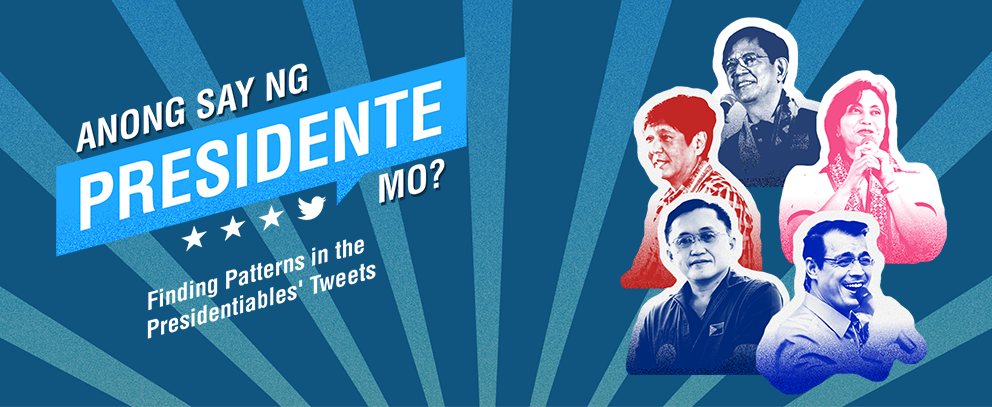

# Highlights
1. Since social media is regarded as the new TV, Twitter has the potential to influence its users' political views.
2. As the election season has only begun, the presidentiables have yet to leverage their Twitter presence.
3. Each presidential candidate has distinct topics, styles, and word choices in their tweets.
4. The candidates’ followers value original and personalized content, as well as an uninterrupted Twitter experience.
5. Interpretability methods allow for a clear grasp of the business value of model outcomes.

# I. Introduction

#### Anong Say ng Presidente Mo?
On May 9, 2022, the Philippines will hold a national election to end President Duterte's six-year reign and elect a new president who will lead the country to recovery. The country has 97 presidential candidates as of November 15, 2021, the deadline for filing candidacies.[[1]](https://www.rappler.com/nation/elections/comelec-release-tentative-list-candidates-2022-polls-october-29-2021/) Only a few presidential candidates have been active on social media, which appears to be the main source of information and news for Filipinos nowadays.[[2]](https://reutersinstitute.politics.ox.ac.uk/sites/default/files/2021-06/Digital_News_Report_2021_FINAL.pdf)

As campaigns ramp up, the voting populace is eager to learn more about the candidates’ platforms and political positions in order to choose the right candidate for them. By analyzing and identifying patterns in the candidates’ social media engagement, the learning team hoped to glean insights into what topics or issues resonated with their followers. Furthermore, as the rivalry heats up, the candidates fight to attract supporters by ensuring maximum visibility and engagement.

#### Social Media Channel
Twitter reaches 10.2 million Filipino adults, or 6.6% of those eligible to vote, the majority of whom are between the ages of 18 and 34.[[3]](https://datareportal.com/reports/digital-2021-philippines) Because these Gen Zs are known to value communication and transparency,[[4]](https://www.forbes.com/sites/ashleystahl/2021/05/04/how-gen-z-is-bringing-a-fresh-perspective-to-the-world-of-work/?sh=2c6f960f10c2) it is crucial to provide them with information on topics that are relevant to them. Moreover, as the cradle of ‘woke’ and cancel culture,[[5]](https://www.thinkwithgoogle.com/intl/en-apac/consumer-insights/consumer-trends/stay-woke-how-gen-z-teaching-us-about-future-news-and-information/) getting a  glimpse of the issues that resonated with them can be beneficial to the presidential candidates. 

Twitter, on the other hand, being the country's fourth most-used social media platform,[[6]](https://datareportal.com/reports/digital-2021-philippines) can be used to gauge public interest in the candidates. Perhaps it can also be used to reshape their followers' perceptions and combat confirmation bias.

# II. Methodology

*Figure 1* shows an overview of the pipeline employed in this study.

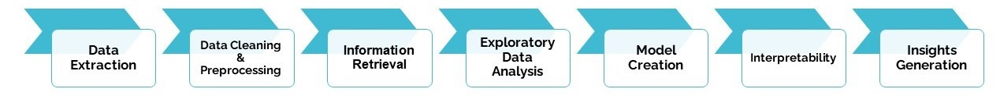


<center> Figure 1. Overview of the Methodology

**1. Data Extraction**
<br>Web scraping using Twitter API was utilized to collect data from the user accounts of the five most popular presidentiables on the platform.
<br>
<br>
<center>
       Table 1. Details of the Collected Data
</center>

| Presidentiable | Twitter URL | Date of First Tweet | Date of Last Tweet | Total Number of Tweets |
| :---: | :---: | :----: |:---:|:---:|
| <b>Leni Robredo</b> | https://twitter.com/lenirobredo | Mar 2020 | Nov 2021 | 824
| <b>Bongbong Marcos</b> | https://twitter.com/bongbongmarcos | Aug 2019 | Nov 2021 | 850
| <b>Isko Moreno</b> | https://twitter.com/IskoMoreno | Aug 2020 | Nov 2021 | 723
| <b>Ping Lacson</b> | https://twitter.com/iampinglacson | July 2016 | Nov 2021 | 846
| <b>Bong Go</b> | https://twitter.com/SAPBongGo  | Jan 2019 | Nov 2021 | 781

<br> The team also collected data from two other presidential candidates visible on Twitter:
<br>&emsp; a. Manny Pacquiao: https://twitter.com/MannyPacquiao; excluded in the analyses because his tweets are focused on promoting his boxing matches. 
<br>&emsp; b. Ka Leody: https://twitter.com/leodymanggagawa; excluded in the analyses because he only tweeted 18 times, all with low engagement.

Apart from the texts from the first tweets in threads, the team also retrieved the following engagement data from each username:
<br>&emsp; a. Likes count
<br>&emsp; b. Retweet count
<br>&emsp; c. Quote-Tweet count
<br>&emsp; d. Replies count
<br>
<br>

**2. Data Cleaning and Preprocessing**
<br> Before the model can recognize and interpret human language, several preprocessing steps occur in the backend. The features to be analyzed are text tweets from the presidentiables' official user accounts, and  text data are often messy. To prepare the data for modeling and analysis, the following steps were followed:

***a. Converting accented characters to their base form***
<br> Accented characters are important aspects that are used to emphasize a certain word during pronunciation or comprehension. Résumé, café, prótest, divorcé, coördinate, exposé, and latté are a few examples.

***b. Lemmatization***
<br> Lemmatization is a process of converting text to their word stem, base, or root form.

***c. Converting to lowercase***
<br>The lower function was used to convert the characters or words to lowercase.

***d. Removing punctuation, numbers and special characters***
<br>Special characters are non-alphanumeric characters that add no value to text comprehension, and may cause noise in algorithms. Regular expressions (RegEx) was used to eliminate these characters.

***e. Removing stop words***
<br>Filtering out useless data is a common type of data preprocessing. Stop words are considered meaningless in natural language processing, and are ignored in analysis. The stop words were filtered and deleted using the `NLTK` stop words and `advertools` modules.

***f. Removing extra whitespaces and tabs***
<br>Extra whitespaces and tabs were also removed because they provide no value to text processing.

***g. Removing emojis***
<br>Emojis are small digital images or icons that are widely used in messaging and social media. Because the collected emojis are scarce, they were excluded in this study.
<br>
<br>

**3. Information Retrieval**
<br>The ***Term Frequency and Inverse Document Frequency (TF-IDF)*** featurization method was used to determine the relevance of the words to the entire tweet samples. The corpus are converted to a sparse matrix of TF-IDF score, wherein the rows represent words and columns represent documents. TF-IDF assigns a weight for term *j* in document *i* as follows:
    
  $$ w_{i,j} = tf_{i,j} \times \log(\frac{N}{df_i}) $$
 where:
 - $tf_{i,j}$ is the number of occurence of *i* in *j* 
 - $df_i$ is the number of documents containing *i*
 - $N$ the total documents

The TF-IDF sparse matrices representation of token counts served as the bases for the two sets of models created in this project: binary classification and multi-class classification.
<br>
<br>

**4. Exploratory Data Analysis (EDA)**
<br>EDA was performed to the cleaned and preprocessed data in order to obtain insights into the overall behavior of the datasets. The methods performed varied from basic descriptive statistics to data visualization through the use of line charts, boxplots, and word clouds.
<br>
<br>

**5. Model Creation**
<br> The team created two sets of model to fulfill the project objective:
<br> 
<br>&emsp; ***a. Five binary classification models*** 
<br>&emsp; These models were used to identify the features that have high and low levels of engagement for each candidate, and included the following steps:
<br>&emsp; a. Binning of the the least and most engaged tweets using a quantile-based discretization function ***qcut***. 
<br>&emsp; b. Implementing the seven ML classification models using the candidate as the target variable and the words/texts of their tweets as the features.
 <br>&emsp; &emsp; &emsp;Decision Tree
 <br>&emsp; &emsp; &emsp;Random Forest
 <br>&emsp; &emsp; &emsp;Gradient Boosting Method
 <br>&emsp; &emsp; &emsp;Logistic Regression (L1)
 <br>&emsp; &emsp; &emsp;Linear SVM (L1)
 <br>&emsp; &emsp; &emsp;Logistic Regression (L2)
 <br>&emsp; &emsp; &emsp;Linear SVM (L2)
<br>&emsp; c. Improving the model by hypertuning the parameters.
<br>&emsp; d. Using the accuracy metric to evaluate the models, and determine the best model and corresponding predictor.
<br>   

<br>&emsp; ***b. Two multi-class classification models***
<br>&emsp; The team explored two models to predict which candidate is most likely to post a given tweet.
<br>&emsp; The models utilized all of the data collected from the selected presidential candidates, and were evaluated using the accuracy scores and confusion matrix. 
<br>&emsp; The models differ in the following:
<br>&emsp; &emsp; Model 2a: included both text and numerical data; the target variable was the candidate, and the features were the words or text of the tweets,
<br>&emsp; &emsp; along with engagement metrics.
<br>&emsp; &emsp; Model 2b: included all text data only, wherein the target variable was the candidate, and the features were the words or text of the tweets.

<br>

**6. Interpretability**
<br>Model interpretability methods were integrated into this study to ensure that the results of the models are intuitive to the target stakeholders. This was also critical to the team’s understanding of the feature words that drive the low and high prediction.

***a. SHAP***
<br>The team implemented SHapley Additive exPlanations (SHAP) using Logistic Regression as the base model to identify the words or topics that are important to each binary classification model that represents each candidate. Linear Explainer was utilized because the base is a linear model.

***b. LIME***
<br>The Local Interpretable Model-agnostic Explanations (LIME) technique was applied to the multi-class classification models to determine the likelihood that a specific candidate would post an input string of words, or synthetic tweets as the team coined them.
<br>
<br>

**7. Insights Generation**
<br>The interpretability methods extracted the important feature words from the two sets of models. The team then created visualizations to interpret the  results and generate insights.
 
***a. SHAP Beeswarm Plots***
<br>These are information-dense summaries of how the top feature words in tweet samples impact the models' prediction. This type of visualization was primarily used for binary classification models to determine which topics or issues resonated the most and least with the presidentiables' followers.
 
***b. Word Clouds***
<br>This type of visualization was used in conjunction with the SHAP beeswarm plots. These are graphical representations of the feature words' SHAP values multiplied by 100 for display purposes.
 
***c. LIME Visualization***
<br>The LIME charts were utilized in the second set of models to display the contribution of each feature word to the prediction of the candidate most likely to have posted the input/synthetic tweets. This enabled the team to determine which words had the biggest impact on the prediction.

***d. Screenshots of the Actual Tweets***
<br>To complete the storytelling, the team visited the candidates’ Twitter pages and queried the low and high-scoring feature words identified from the above visualizations. This step enabled the team to gain context and understand the behaviors of the candidates’ Twitter followers.

# III. Data Description

As briefly discussed in the previous section, the Presidential Candidates' Tweets dataset is constructed by utilizing the Twitter API (*please see separate notebook 'Supplementary Notebook- Using Twitter API' for the Python implementation*). For this project, the team decided to store the dataset in CSV format for easy processing. The table below provides all the fields from the testing data:

<br>
<center>
       Table 2. Fields of the Presidential Candidates' Tweets Dataset
</center>


| <center>Column Name</center> | <center>Data Type</center> | <center>Description</center> |
|:-|:-|:-|
|`id`|`int`|Unique ID of the tweet|
|`created_at`|`date`|Date and time the tweet is posted in the platform|
|`text`|`string`|Text content of the tweet, including links to media and other sites|
|`public_metrics.retweet_count`|`int`|Total number of retweets the tweet obtained|
|`public_metrics.reply_count`|`int`|Total number of replies the tweet obtained|
|`public_metrics.like_count`|`int`|Total number of likes the tweet obtained|
|`public_metrics.quote_count`|`int`|Total number of quote tweets (retweets with caption) the tweet obtained|
|`username`|`string`|The username of the tweet creator|

<center> Table 3. First Five Rows of the Presidential Candidates' Tweets Dataset </center>

In [59]:
df = pd.read_csv('candidate_tweetsv2.csv')
df = df[~df.username.isin(['MannyPacquiao', 'LeodyManggagawa'])]
df.head()

,Unnamed: 0,id,created_at,text,public_metrics.retweet_count,public_metrics.reply_count,public_metrics.like_count,public_metrics.quote_count,username
0,0,1462771275068182536,2021-11-22T13:13:43.000Z,The first shipment of Molnupiravir arrived in ...,490,25,4446,62,lenirobredo
1,1,1462771273537228802,2021-11-22T13:13:43.000Z,"In the agreement, the OVP will issue a guarant...",404,15,3900,7,lenirobredo
2,2,1462771270773194753,2021-11-22T13:13:42.000Z,"Molnupiravir, an oral pill for the treatment o...",8454,274,34237,1287,lenirobredo
3,3,1461314152924803079,2021-11-18T12:43:38.000Z,Dami na naman nangyayari 🔥 \n\nPero ito ang us...,4154,434,62592,763,lenirobredo
4,4,1460634783189331968,2021-11-16T15:44:04.000Z,There’s a new baby in the house and it was lov...,1838,320,38477,321,lenirobredo


# IV. Exploratory Data Analysis (EDA)

## A. Summary Statistics per Candidate

We perform data exploration based on the collected data. The sections below will illustrate the count of candidate tweets collected. 

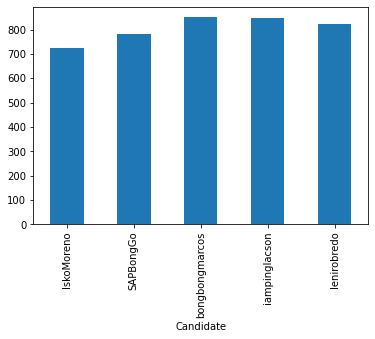

In [26]:
# plot count of tweets per candidate
tweet_count(df)

<center> Figure 2. Count of Tweets per Candidate

We also present below the tweets over time per candidate, including the earliest and latest tweet available in our dataset. Additionally, the count, and the relevant quartiles are also presented.

Count of Tweets: 723
Earliest Tweet: August 28, 2020
Latest Tweet: November 24, 2021


count       723
mean        821
std       2,850
min          11
25%          67
50%         116
75%         410
max      39,015
Name: total_engagement, dtype: object

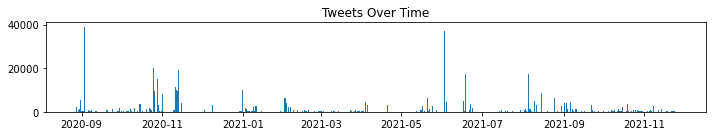

In [27]:
tweet_distribution(df, 'IskoMoreno')

<center> Figure 3. Count of Tweets Over Time for IskoMoreno

Count of Tweets: 781
Earliest Tweet: January 05, 2019
Latest Tweet: October 01, 2021


count      781
mean        60
std        170
min          0
25%          1
50%          5
75%         26
max      1,443
Name: total_engagement, dtype: object

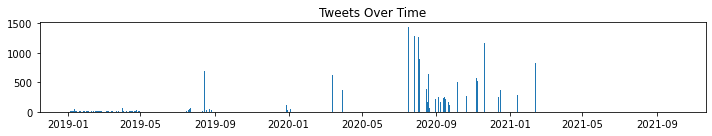

In [28]:
tweet_distribution(df, 'SAPBongGo')

<center> Figure 4. Count of Tweets Over Time for SAPBongGo

Count of Tweets: 850
Earliest Tweet: August 14, 2019
Latest Tweet: November 21, 2021


count       850
mean      1,029
std       2,617
min          17
25%         141
50%         242
75%         454
max      19,322
Name: total_engagement, dtype: object

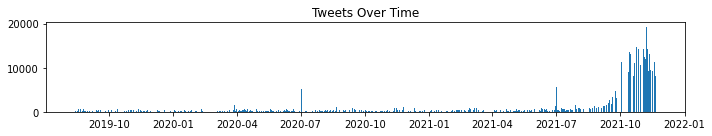

In [29]:
tweet_distribution(df, 'bongbongmarcos')

<center> Figure 5. Count of Tweets Over Time for bongbongmarcos

Count of Tweets: 846
Earliest Tweet: July 22, 2016
Latest Tweet: November 23, 2021


count        846
mean       1,156
std        5,014
min            8
25%          148
50%          359
75%          820
max      125,870
Name: total_engagement, dtype: object

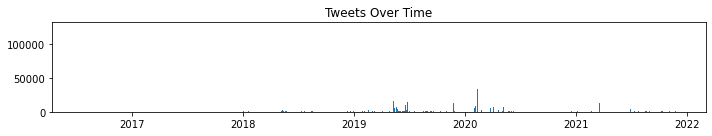

In [30]:
tweet_distribution(df, 'iampinglacson')

<center> Figure 6. Count of Tweets Over Time for iampinglacson

Count of Tweets: 824
Earliest Tweet: March 21, 2020
Latest Tweet: November 22, 2021


count        824
mean       9,731
std       22,821
min            4
25%           30
50%        1,202
75%        7,690
max      209,510
Name: total_engagement, dtype: object

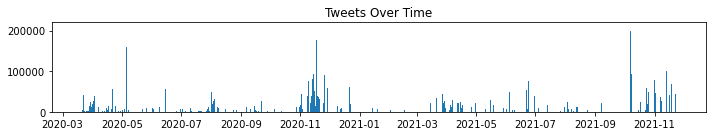

In [31]:
tweet_distribution(df, 'lenirobredo')

<center> Figure 7. Count of Tweets Over Time for lenirobredo

## B. Word Cloud

Word cloud can be used to visualize the distribution and characteristics of words which is going to be the basis of preprocessing techniques such as TFIDF, lemmatization, filtering of most and least common words.

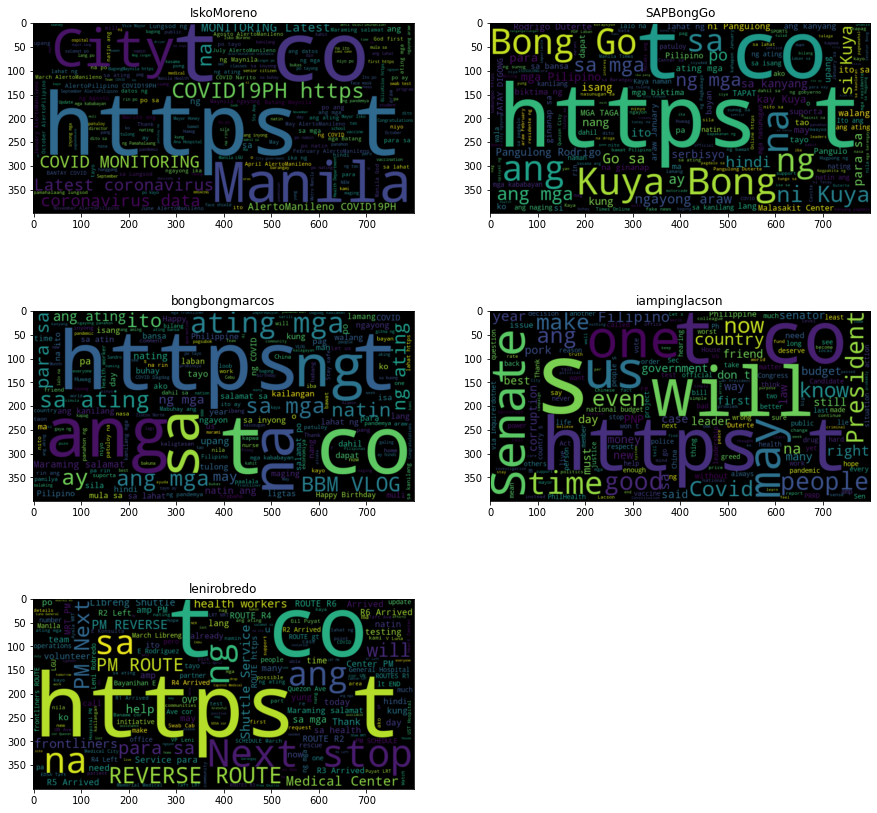

In [32]:
word_cloud_candidate(df)

<center> Figure 8. Word Cloud per Candidate

The team created a word cloud for each of the candidate and observed the following:
- It is common for the presidentiables to use external links on their tweets. The team decided to remove this links as these are not indicative of the topic that the presidentiables present. 
- Words are in mixed case. The team performed casefolding to enable case-insensitive words such that we want <code>Manila</code> and <code>MANILA</code> to be counted as single word.
- Filipino and English words are the most common language that the presidentiables used for their tweets. We removed English stopwords from <code>nltk stopwords</code> and Filipino stopwords from <code>advertools</code> to prevent low-level information such as <code>about</code>, <code>without</code>, etc from our tweets in order to give more importance to the relevant information

# V. Results and Discussion

## V.A. Binary Classification Models

### 1. Hyperparameter Tuning

<p style="text-align:justify">In order to maximize the accuracy of our models, the team have performed hyperparameter tuning on seven different models that are error based and information based models. The team used stratified train test split with 25% of the dataset as test size and on 10 trials. The chosen metric that the team used in selecting the best model and hyperparameter is accuracy since the data in these models are balanced.</p>

In [34]:
for cand_name in df.username.unique():
    display(HTML(f'<b>{cand_name}</b>'))
    X, y, tfidf_vectorizer = get_feat_targ(df, cand_name, qcut=2, ngram_start=1)
    display(train(X, y))

Linear SVM (l2): 100%|██████████| 10/10 [00:02<00:00,  3.77it/s]


,Machine Learning Method,Test Accuracy,Best Parameter,Top Predictor Variable,Run Time
0,Decision Tree,0.846602,max_depth = 3,route,3.402227
1,Random Forest,0.854369,max_depth = 9,route,21.699299
2,Gradient Boost,0.846602,max_depth = 6,route,16.701467
3,Logistic Regression (l1),0.849029,C = 1,route,2.573397
4,Linear SVM (l1),0.848058,C = 1,route,3.689852
5,Logistic Regression (l2),0.857767,C = 1,route,3.913873
6,Linear SVM (l2),0.859709,C = 0.1,frontliners,2.657882


Linear SVM (l2): 100%|██████████| 10/10 [00:02<00:00,  4.15it/s]


,Machine Learning Method,Test Accuracy,Best Parameter,Top Predictor Variable,Run Time
0,Decision Tree,0.530516,max_depth = 1,birthday,2.336894
1,Random Forest,0.567136,max_depth = 9,birthday,20.582212
2,Gradient Boost,0.574648,max_depth = 7,birthday,12.306759
3,Logistic Regression (l1),0.561033,C = 1,birthday,2.947695
4,Linear SVM (l1),0.556338,C = 1,birthday,2.016772
5,Logistic Regression (l2),0.570892,C = 0.1,health worker,3.233338
6,Linear SVM (l2),0.569484,C = 0.01,health worker,2.413544


Linear SVM (l2): 100%|██████████| 10/10 [00:02<00:00,  4.82it/s]


,Machine Learning Method,Test Accuracy,Best Parameter,Top Predictor Variable,Run Time
0,Decision Tree,0.827624,max_depth = 8,covid,2.173824
1,Random Forest,0.835359,max_depth = 9,covid,20.346331
2,Gradient Boost,0.827072,max_depth = 3,covid,13.209447
3,Logistic Regression (l1),0.821547,C = 1,mayor honey,3.185003
4,Linear SVM (l1),0.815470,C = 1,mayor honey,2.807113
5,Logistic Regression (l2),0.837017,C = 1,mayor honey,3.274141
6,Linear SVM (l2),0.834254,C = 0.1,mayor honey,2.076916


Linear SVM (l2): 100%|██████████| 10/10 [00:02<00:00,  4.39it/s]


,Machine Learning Method,Test Accuracy,Best Parameter,Top Predictor Variable,Run Time
0,Decision Tree,0.639286,max_depth = 8,bong,3.045196
1,Random Forest,0.670918,max_depth = 9,kuya bong,20.927461
2,Gradient Boost,0.697959,max_depth = 6,kuya,14.877721
3,Logistic Regression (l1),0.681633,C = 1,mensahe,4.998613
4,Linear SVM (l1),0.687755,C = 1,mensahe,3.152949
5,Logistic Regression (l2),0.719388,C = 1,mensahe,3.292453
6,Linear SVM (l2),0.721429,C = 0.1,mensahe,2.282287


Linear SVM (l2): 100%|██████████| 10/10 [00:02<00:00,  3.92it/s]


,Machine Learning Method,Test Accuracy,Best Parameter,Top Predictor Variable,Run Time
0,Decision Tree,0.543396,max_depth = 8,country,2.668103
1,Random Forest,0.572642,max_depth = 8,country,20.946760
2,Gradient Boost,0.574528,max_depth = 7,country,13.516865
3,Logistic Regression (l1),0.576887,C = 1,candidate vote,2.770257
4,Linear SVM (l1),0.554245,C = 1,candidate vote,1.962797
5,Logistic Regression (l2),0.561321,C = 1,candidate vote,3.371040
6,Linear SVM (l2),0.560849,C = 0.1,candidate vote,2.553544


### 2. Model Interpretability

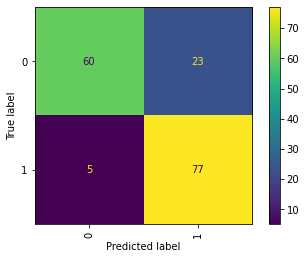

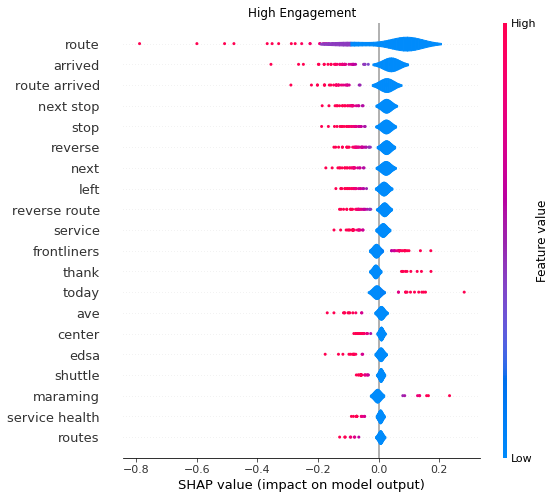

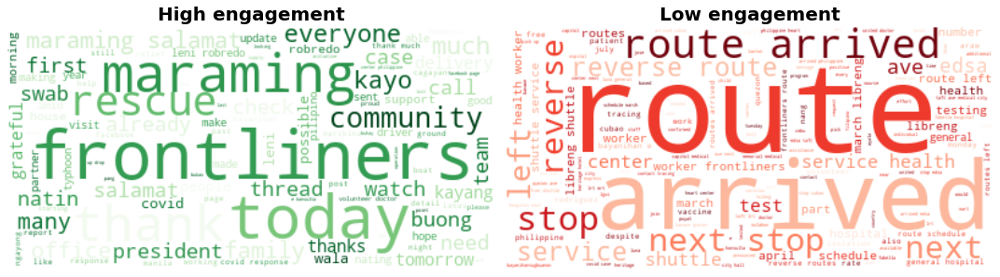

In [36]:
i = 0
shap_wordcloud(models[i], candidates[i], df, cols_exclude[i], 
               'PM REVERSE ROUTES', 'medical frontliners')

<center> Figure 9. Confusion Matrix, SHAP Summary Plot, Word Cloud and Lime Interpretation of Sample Tweets for Leni Robredo

<p style="text-align:justify">Leni Robredo’s tweets with words like <code>frontliners</code>, <code>thank</code>, and <code>today</code> are more likely to get higher engagement from her followers. These are indicative of tweets of appreciation for frontliners during the pandemic, as well as daily updates of her activities, usually accompanied by photos. However, her tweets with words like <code>route</code>, <code>arrived</code>, and <code>stop</code> are indicative of PSA-like tweets about the free shuttle service of the OVP,  and are often met with low engagement.</p> 

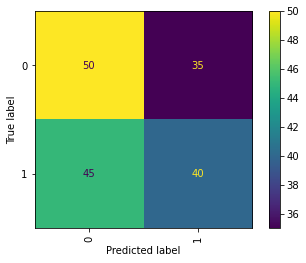

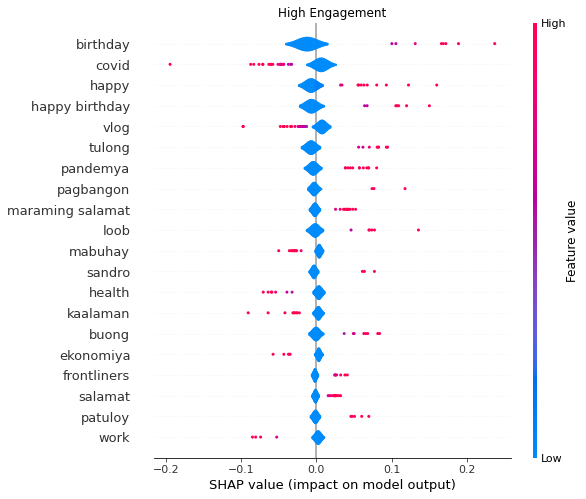

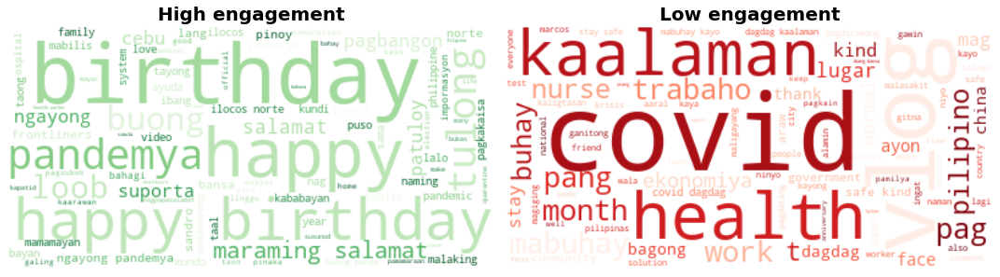

In [9]:
i = 1
shap_wordcloud(models[i], candidates[i], df, cols_exclude[i], 
               'vlog', 'birthday')

<center> Figure 10. Confusion Matrix, SHAP Summary Plot, Word Cloud and Lime Interpretation of Sample Tweets for Bong Bong Marcos

<p style="text-align:justify">Looking at Bongbong Marcos’s tweets, those with words like <code>happy</code> and <code>birthday</code>, which are obviously indicative of personal birthday wishes, are more likely to get higher engagement from his followers. Likewise with words like <code>tulong</code> and <code>pandemya</code>, which are indicative of tweets in Filipino. </p>

 

<p style="text-align:justify">On the other hand, those with words like <code>vlog</code>, which are obviously promotions for his personal vlog, are met with low engagement, as well as those with words like <code>health</code> and <code>covid</code>, which are indicative of his tweets in English.</p>

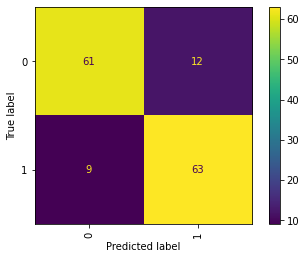

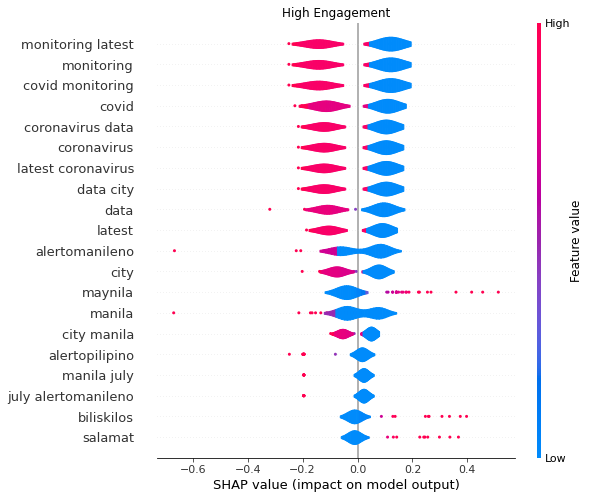

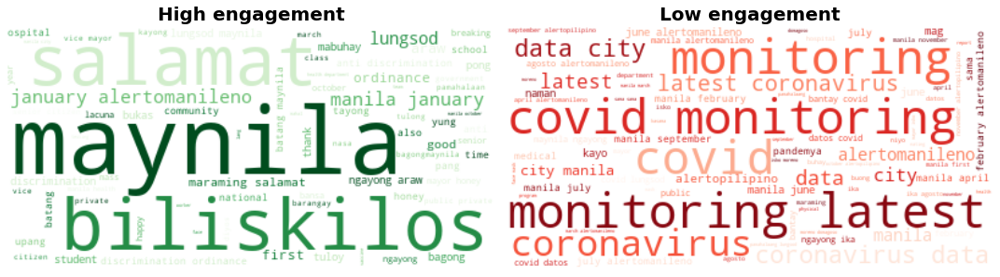

In [10]:
i = 2
shap_wordcloud(models[i], candidates[i], df, cols_exclude[i], 
               'coronavirus', 'maynila')

<center> Figure 11. Confusion Matrix, SHAP Summary Plot, Word Cloud and Lime Interpretation of Sample Tweets for Isko Moreno

<p style="text-align:justify">Isko Moreno, as the mayor of the City of Manila, frequently posts about the interests of his city. His high-engagement tweets usually include words like <code>maynila</code>, <code>salamat</code>, and <code>biliskilos</code>, which are indicative of posts in Filipino. These are also usually accompanied by photos, frequently with him in it. On the other hand, his low-engagement tweets usually include words like <code>covid</code>, <code>monitoring</code>, <code>latest</code>, and <code>manila</code>, which are indicative of PSA-like tweets about the COVID situation in Manila that are posted in English.</p>

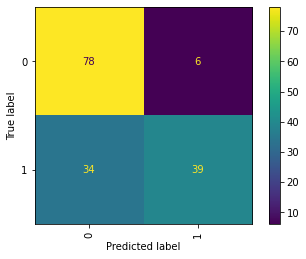

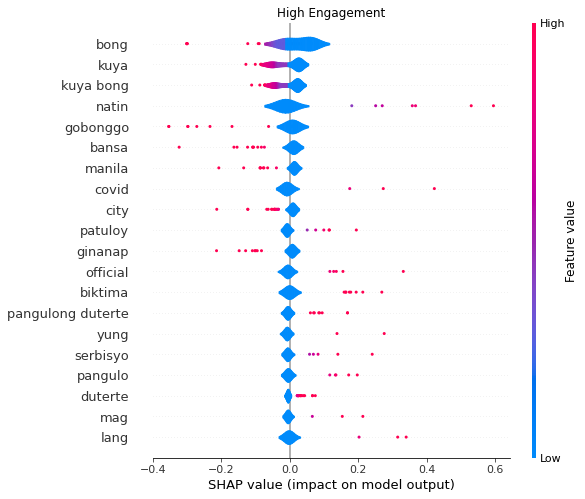

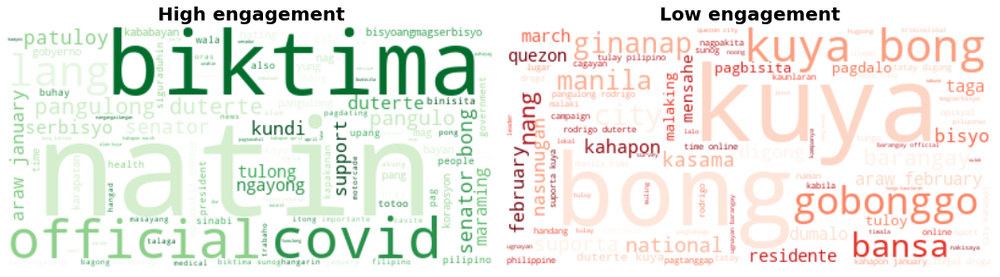

In [11]:
i = 3
shap_wordcloud(models[i], candidates[i], df, cols_exclude[i], 
               'bong', 'biktima')

<center> Figure 12. Confusion Matrix, SHAP Summary Plot, Word Cloud and Lime Interpretation of Sample Tweets for Bong Go

<p style="text-align:justify">Bong Go was included in the analysis as he was still in the presidential race when this analysis was performed. His is a particularly interesting case as most of his tweets are in Filipino, which did not make a particularly good predictor for the level of engagement his tweet received. However, we noticed that his tweets about Rodrigo Duterte, denoted by the words <code>pangulong duterte</code>, frequently received high engagement, while promotional tweets about himself, denoted by the words <code>kuya</code>, <code>bong</code>, or <code>kuya bong</code>, frequently received low engagement.</p>

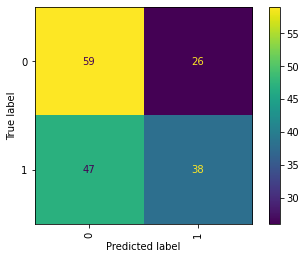

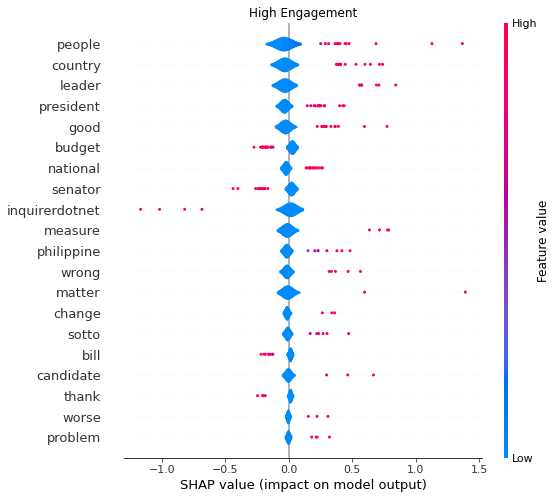

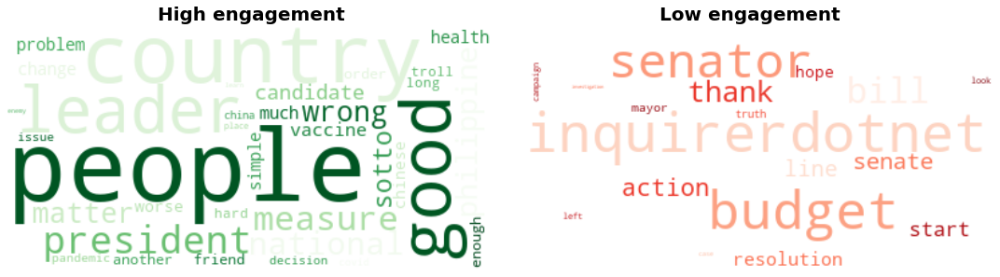

In [12]:
i = 4
shap_wordcloud(models[i], candidates[i], df, cols_exclude[i], 
               'inquirerdotnet', 'country')

<center> Figure 13. Confusion Matrix, SHAP Summary Plot, Word Cloud and Lime Interpretation of Sample Tweets for Ping Lacson

<p style="text-align:justify">Lastly, most of Ping Lacson's tweets express dissent against the government. However, a key difference between his high- and low-engagement tweets is that the former are typically one- to two-sentence tweets that appeal to his followers' emotions, as denoted by words like <code>people</code>, <code>country</code>, <code>leader</code>, and<code>good</code>, while the latter are frequently technical in nature, as denoted by words like <code>senator</code>, <code>budget</code>, and <code>bill</code>.</p>

## V.B. Multi-class Classification Models

The second set of models the group trained is a multi-classification model where the target variable is the candidate and the features are the texts of tweets. We discuss the results below.

### 1. Hyperparameter Tuning


For the multi-class classification model, the team have performed hyperparameter tuning by selecting the ideal hyperparameter that maximizes accuracy. Accuracy is chosen for this models since ideally, the model would correctly predict who among the 5 candidates would be tweeting a specific statement. The team used stratified train test split with 25% of the dataset as test size using 10 trials.

Linear SVM (l2): 100%|██████████| 10/10 [00:10<00:00,  1.02s/it]


,Machine Learning Method,Test Accuracy,Best Parameter,Top Predictor Variable,Run Time
0,Decision Tree,0.570875,max_depth = 9,bong,2.098913
1,Random Forest,0.647117,max_depth = 9,kuya bong,29.986311
2,Logistic Regression (l1),0.727038,C = 10,alertomanileno,2.241331
3,Linear SVM (l1),0.725547,C = 1,friend,4.264189
4,Logistic Regression (l2),0.727634,C = 1,bong,9.792253
5,Linear SVM (l2),0.726342,C = 1,alertomanileno,10.177638


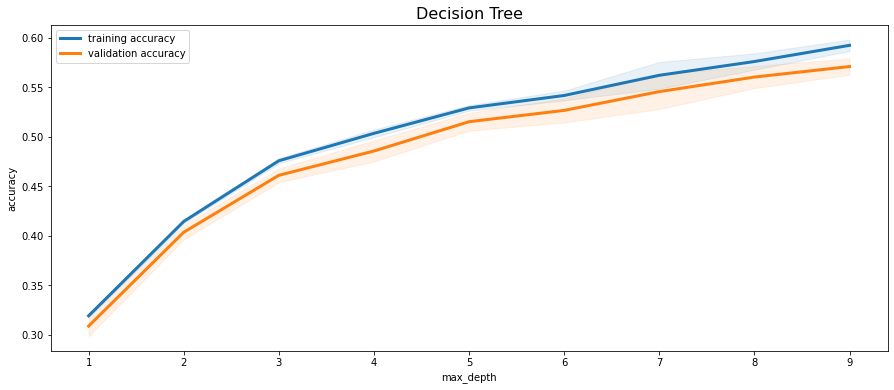

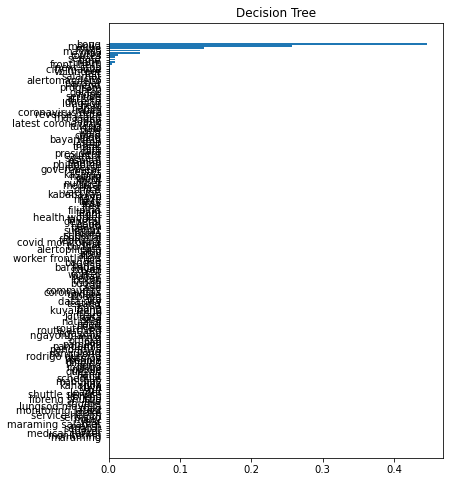

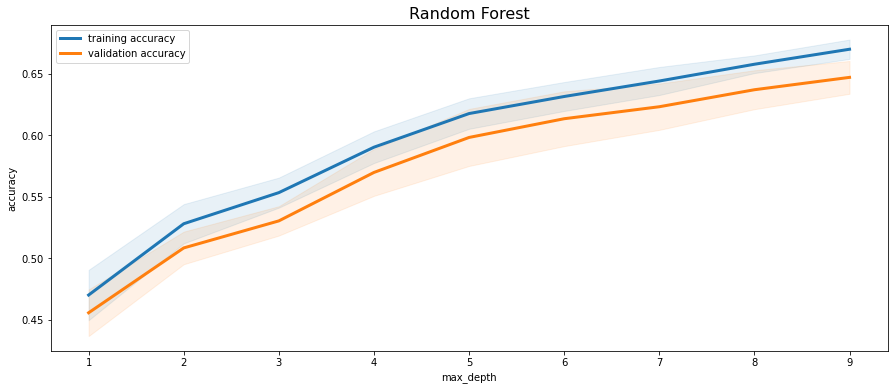

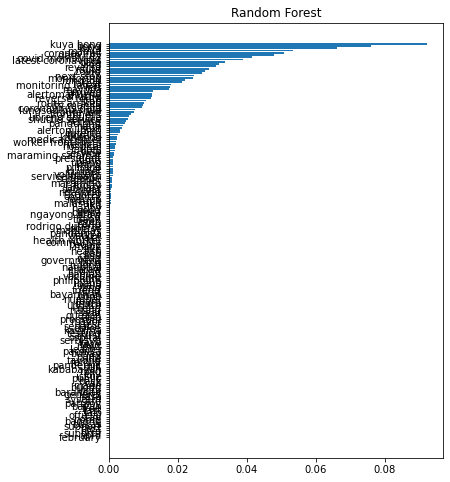

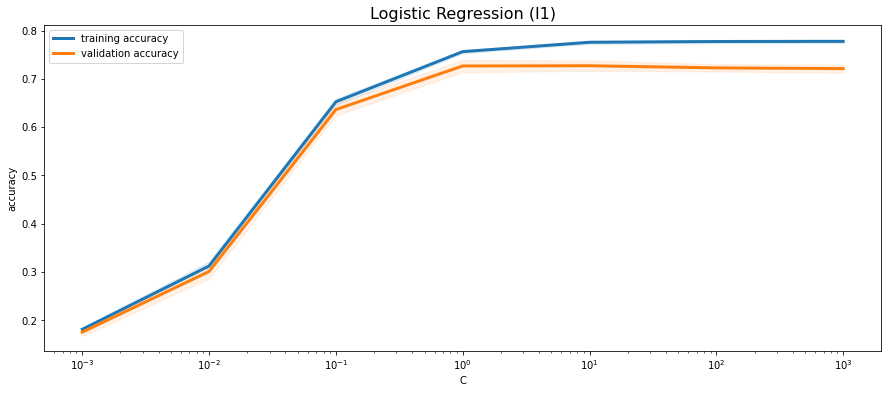

...

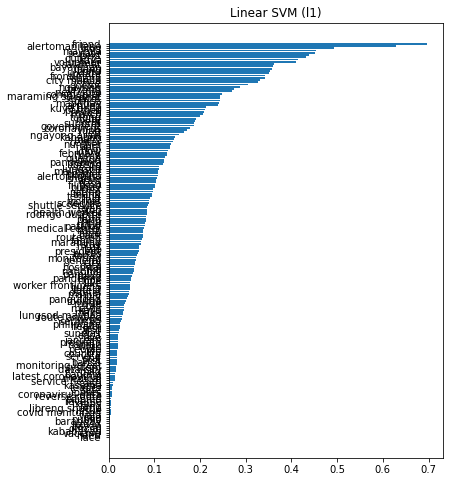

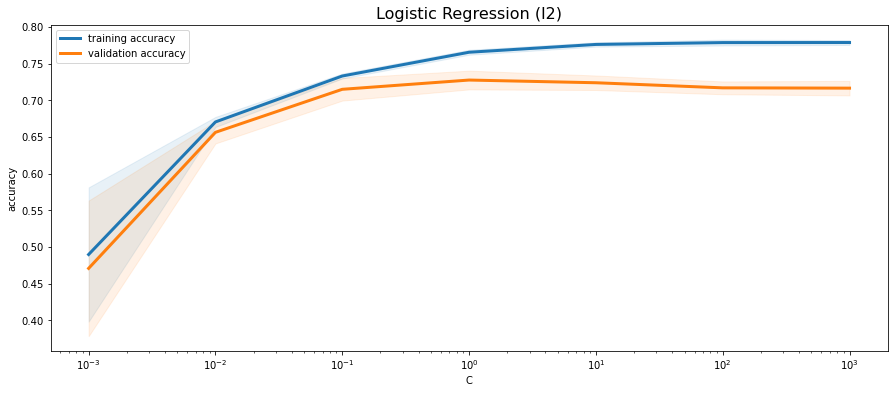

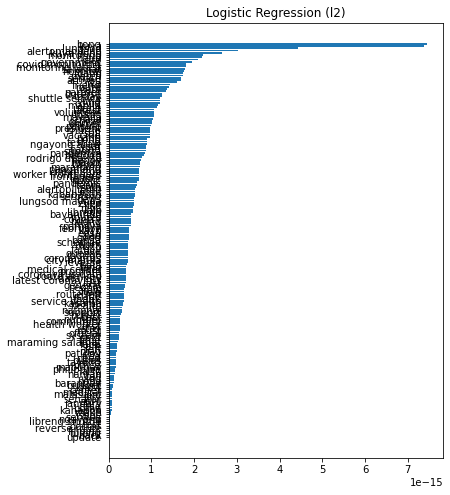

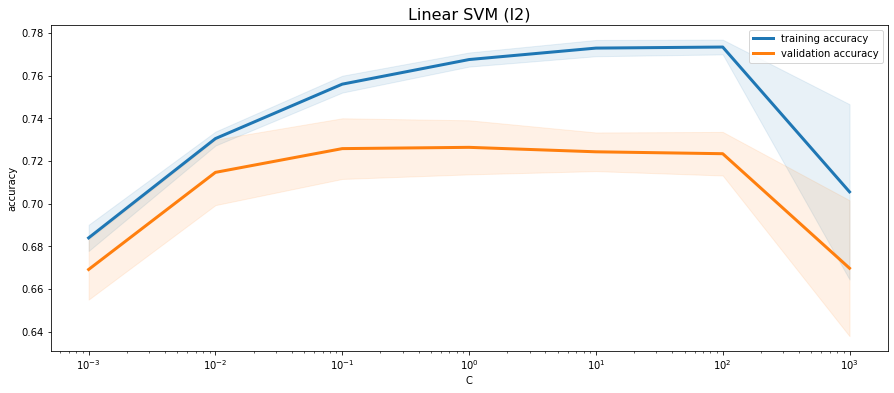

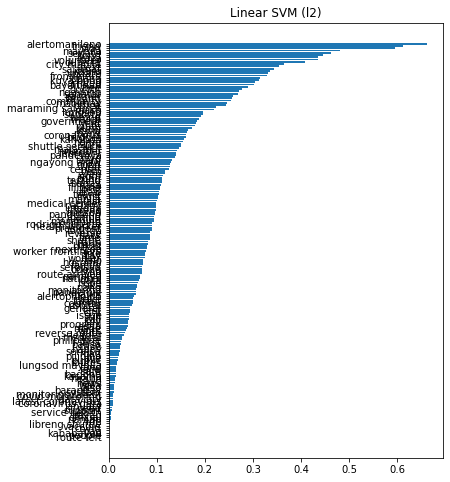

In [6]:
mc_df = df.drop('Unnamed: 0', axis=1)
X, y = multi_class_preprocessing(mc_df)
multi_class_model(X, y)

<center> Figure 14. Hyperparameter plots and results for Multiclass Classification

Based on the results above, we choose Logistic Regression with `l2` regularization and hyperparameter `C=1` since this model provides the highest Test Accuracy at 72.7634%.

### 2. Model Interpretability

Using the selected model mentioned above for the multi-class classification problem, we present below the drivers for this multi-class problem using SHAP for global interpretability and LIME for local interpretability. The next few section of code will discuss this.

#### 2.1 Interpretability through SHAP

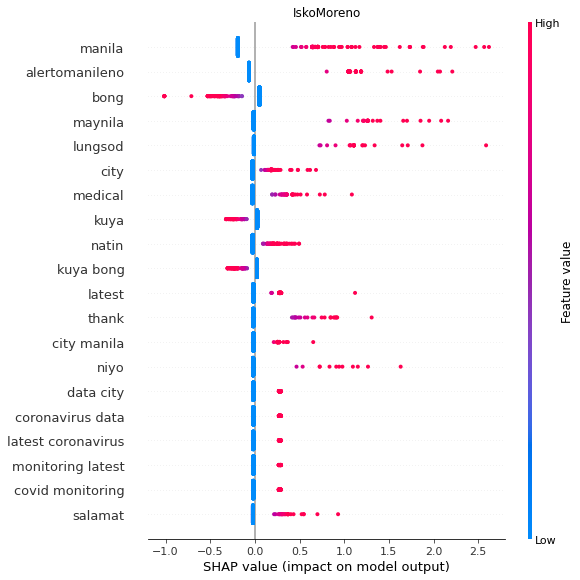

In [62]:
multi_class_viz(X, y, mc_df, 0)

Based on the SHAP plot above, we see that if the tweet contains 'manila', 'maynila', or other related text or hashtag, it is highly likely that Isko Moreno tweeted it. If the tweet contains 'bong' or 'kuya' then it is highly unlikely that Isko Moreno tweeted such tweet. Other words that have dominant red dots on the right side of the plot can explain a high likelihood of Isko tweeting the text is displayed above.

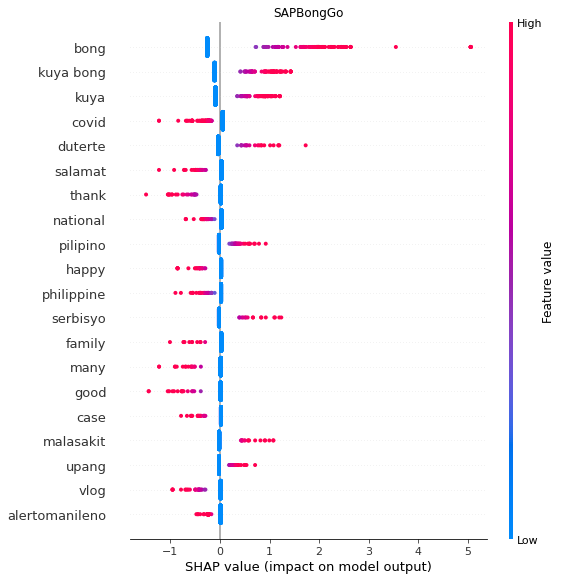

In [63]:
multi_class_viz(X, y, mc_df, 1)

Based on the SHAP plot above, we see that if the tweet contains 'kuya', 'kuya bong', 'bong', 'duterte', or 'serbisyo' it is highly likely that Bong Go tweeted it. If the tweet contains 'covid' or 'salamat', etc. then it is highly unlikely that Bong Go tweeted such tweet. Other words that have dominant red dots on the left side of the plot can explain a low likelihood of Bong Go  tweeting the text is displayed above.

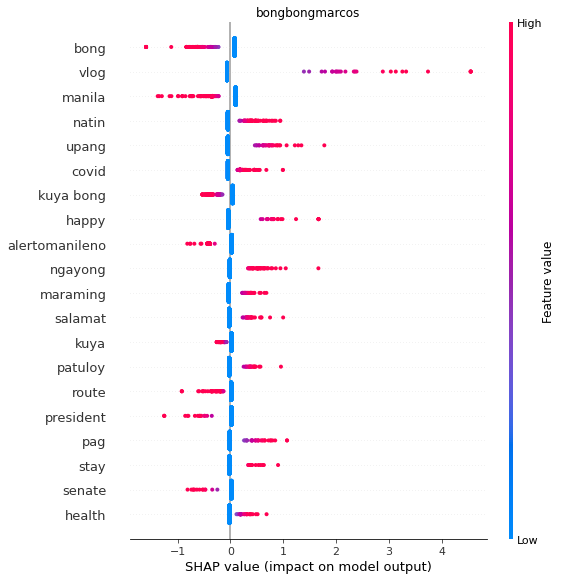

In [64]:
multi_class_viz(X, y, mc_df, 2)

Based on the SHAP plot above, we see that if the tweet contains 'vlog', 'covid', or tagalog words 'natin', 'upang' it is highly likely that Bongbong Marcos tweeted it. If the tweet contains 'manila' or 'kuya bong', etc. then it is highly unlikely that Bongbong Marcos tweeted such tweet. Other words that have dominant red dots on the right side of the plot can explain a high likelihood of Bongbong Marcos  tweeting the text is displayed above.

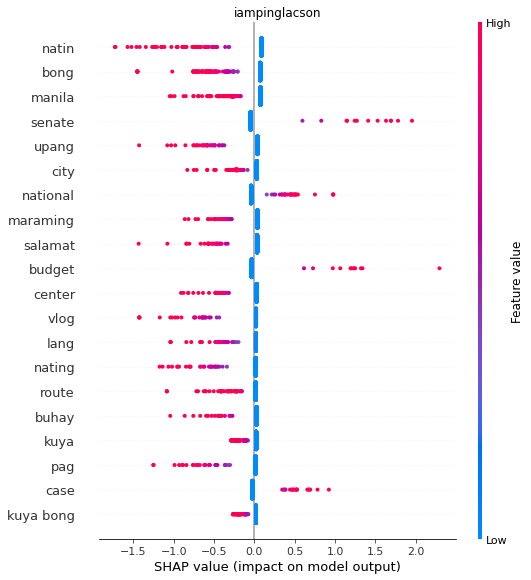

In [65]:
multi_class_viz(X, y, mc_df, 3)

Based on the SHAP plot above, we see that if the tweet contains 'senate', 'national', or 'budget' it is highly likely that Ping Lacson tweeted it. If the tweet contains 'bong', 'manila', etc. then it is highly unlikely that Ping Lacson tweeted such tweet. Other words, which are mostly in Filipino, that have dominant red dots on the left side of the plot can explain a low likelihood of Ping Lacson  tweeting the text is displayed above.

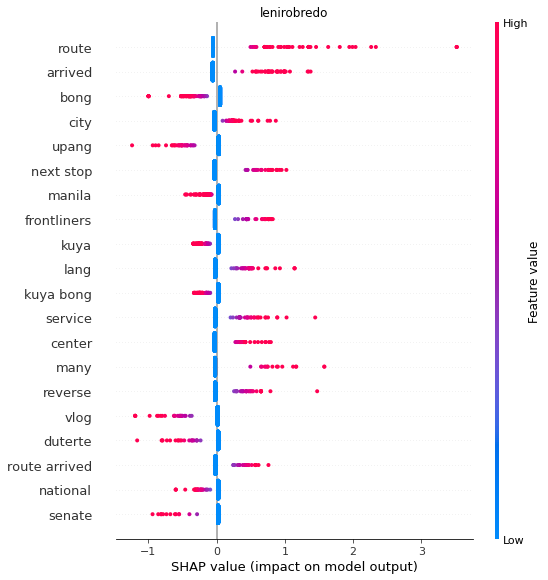

In [66]:
multi_class_viz(X, y, mc_df, 4)

Based on the SHAP plot above, we see that if the tweet contains 'route', 'arrived', or 'city' it is highly likely that Leni Robredo tweeted it. If the tweet contains 'bong', 'upang', 'manila', etc. then it is highly unlikely that Leni Robredo tweeted such tweet. Other words, like 'frontliners', 'service', that have dominant red dots on the right side of the plot can explain a high likelihood of Leni Robredo tweeting the text is displayed above.

#### 2.2 Interpretability through LIME

Below are some tweets pulled from the test dataset and the corresponding actual label and predicted label. The first example is based from a randomized index.

LIME is able to highlight relevant keywords that contribute if the tweet is a certain candidate or note.

In [71]:
sample_index = np.random.randint(len(X_test))
le = LabelEncoder()
y = le.fit_transform(df_all.username)
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.2,
                                                    random_state=143, 
                                                    shuffle=True,
                                                    stratify=y)
model = LogisticRegression(C = 1)
model.fit(X_train.to_numpy(), y_train)


print('Actual Label:', le.inverse_transform([y_test[sample_index]])[0])
c = make_pipeline(tfidf_vectorizer, model)
class_names = le.classes_
explainer = LimeTextExplainer(class_names = class_names)
exp = explainer.explain_instance(df_all[df_all.index == X_test.iloc[sample_index].name].text[X_test.iloc[sample_index].name], 
                                 c.predict_proba, top_labels=1,
                                 num_features=10)
exp.show_in_notebook()

Actual Label: IskoMoreno


We also present 3 synthetic tweets below which are were not tweeted by the candidate themselves. 

#### Sample 1: 'Get the jab to help the government'


In [72]:
tweet = 'Get the jab to help the government'
exp = explainer.explain_instance(tweet, 
                                 c.predict_proba, top_labels=1,
                                 num_features =10)


exp.show_in_notebook(text=tweet)

#### Sample 2: 'Many of our frontliners do their best in order for us to be vaccinated'


In [74]:
tweet = 'Many of our frontliners do their best in order for us to be vaccinated'
exp = explainer.explain_instance(tweet, 
                                 c.predict_proba, top_labels=1,
                                 num_features =10)


exp.show_in_notebook(text=tweet)

#### Sample 3: 'Maraming salamat at patuloy po tayong nagpapabakuna'


In [75]:
tweet = 'Maraming salamat at patuloy po tayong nagpapabakuna'
exp = explainer.explain_instance(tweet, 
                                 c.predict_proba, top_labels=1,
                                 num_features =10)


exp.show_in_notebook(text=tweet)

### 3. Model Stability

We also present the confusion matrix below and recall scores for reference for the selected model. Based on the Test Recall results, there is no class that deteriorates in performance to discriminate based on the model selected.

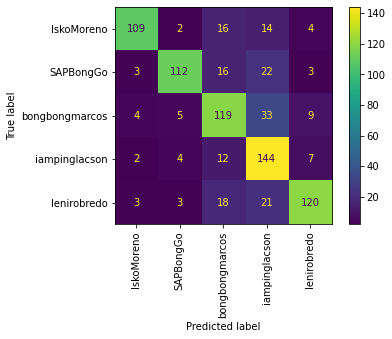

Test Recall for candidate IskoMoreno: 75.17%
Test Recall for candidate SAPBongGo: 71.79%
Test Recall for candidate bongbongmarcos: 70.00%
Test Recall for candidate iampinglacson: 85.21%
Test Recall for candidate lenirobredo: 72.73%

Overall Test Accuracy: 75.0311%


In [76]:
multi_class_viz(X, y, mc_df, 0, conf_matrix=True)

# VI. Key Takeaways

### VI.A. Summary and Conclusion

This study enabled the team to profile the Twitter followers of the presidential candidates. There are some characteristics that overlap with the broader Twitter user demographic, but the distinct behaviors are as follows:
 
#### The candidates’ followers are more inclined to engage in tweets that are: 
* personal and/or appreciative
* express dissent against the government
* update on daily activities, usually with photos
* in Filipino language

#### The candidates’ followers tend to ignore the tweets that contain:
* public service announcements
* embedded links that redirect outside of the platform, disrupting their Twitter experience

<br>
The identified business values can be summarized as follows:

#### Value for Voters:
* find the candidate who advocates for the causes that are important to them
* engage the candidates directly to express support or criticisms
* choose the right candidate to vote

#### Value for Candidates:
* help in attracting more supporters
* ensure that each tweet acquire a high level of engagement
* entertain causes that are not normally covered, yet are significant to the competitors' followers
* enable the social media and campaign managers to address the followers in the candidates’ well-known and effective style, distinct word choices, and right messaging

### VI.B. Extension of the Study

As the election draws closer, more tweets reflecting voters' concerns can be collected and analyzed to provide in-depth insights into their voting preferences and considerations. Insights on controversial election-related issues such as bribery, vote-buying, ghost voting, among others, can also benefit both the candidates and voters, while also aiding in the promotion of fairness throughout the election.

Another application that was not discussed was the extension to other areas of interest. The algorithm and the pipeline are in place, and changing the set of Twitter usernames can lead to new and valuable insights. For example, tweets from anti-environmental sustainability accounts can be analyzed to determine the topics on which their followers agree, providing environmental advocates with talking points for educating the opposition.

# VII. References

[1] Rappler. (29 October 2021). *Comelec releases tentative list of candidates for 2022 polls*. https://www.rappler.com/nation/elections/comelec-release-tentative-list-candidates-2022-polls-october-29-2021.

[2] Reuters Institute. (July 2021). *Reuters Institute: Digital News Report 2021*. https://reutersinstitute.politics.ox.ac.uk/sites/default/files/2021-06/Digital_News_Report_2021_FINAL.pdf.

[3] DataRePortal. (11 February 2021). *Digital 2021: The Philippines*. https://datareportal.com/reports/digital-2021-philippines.

[4] Forbes. (04 May 2021). *How Gen-Z Is Bringing A Fresh Perspective To The World Of Work*. https://www.forbes.com/sites/ashleystahl/2021/05/04/how-gen-z-is-bringing-a-fresh-perspective-to-the-world-of-work/?sh=2c6f960f10c2.

[5] Think with Google. (January 2021). *Stay woke: How Gen Z is teaching us about the future of news and information*. https://www.thinkwithgoogle.com/intl/en-apac/consumer-insights/consumer-trends/stay-woke-how-gen-z-teaching-us-about-future-news-and-information/.

[6] DataRePortal. (11 February 2021). *Digital 2021: The Philippines*. https://datareportal.com/reports/digital-2021-philippines.

# VIII. Appendix

### VIII.A. Using Text and Engagement Metrics for Multi-class Classification (Model 2a)

As discussed briefly in Methodology, two multi-class classification models are created in exploring the best features that will drive our prediction. For this part of the appendix, we will explore how the multi-classification model performs when we include the different engagement metrics: **retweets count**, **likes count**, **replies count**, and **quote tweets count**.

Linear SVM (l2): 100%|██████████| 10/10 [01:32<00:00,  9.29s/it]


,Machine Learning Method,Test Accuracy,Best Parameter,Top Predictor Variable,Run Time
0,Decision Tree,0.722266,max_depth = 9,public_metrics.like_count,3.056781
1,Random Forest,0.756362,max_depth = 9,public_metrics.reply_count,21.650997
2,Gradient Boost,0.838370,max_depth = 9,public_metrics.like_count,488.226231
3,Logistic Regression (l1),0.788370,C = 1,bong,25.884218
4,Linear SVM (l1),0.780417,C = 0.1,friend,32.455381
5,Logistic Regression (l2),0.431909,C = 10,public_metrics.like_count,305.553278
6,Linear SVM (l2),0.651889,C = 0.01,bong,92.942498


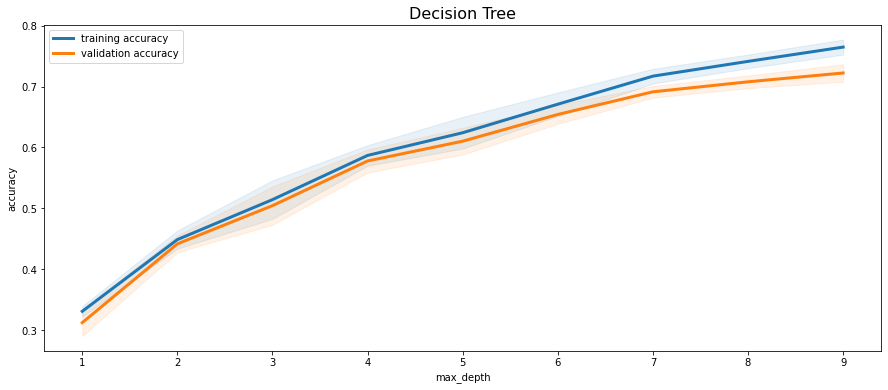

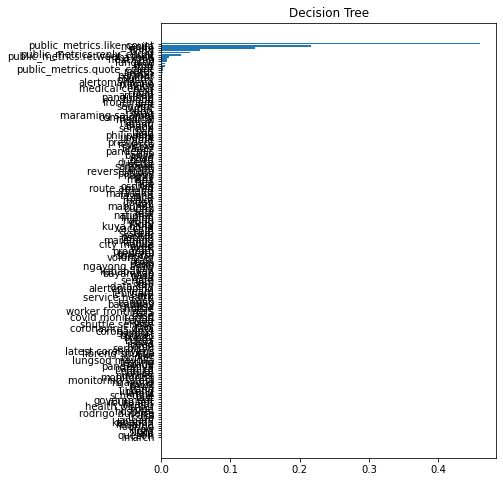

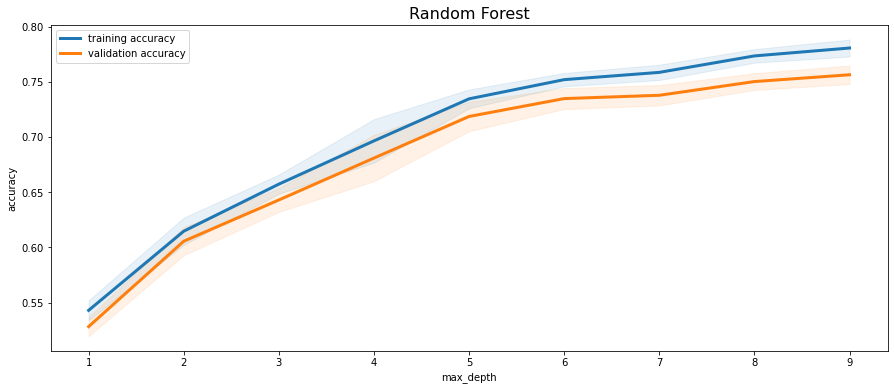

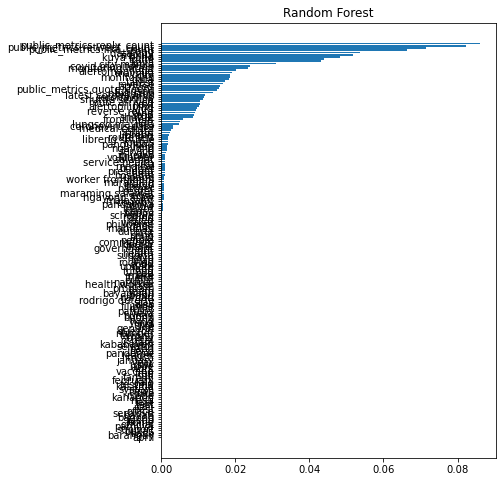

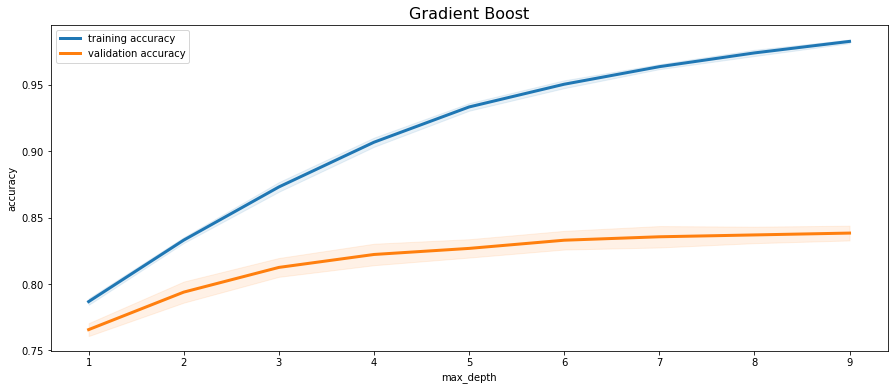

...

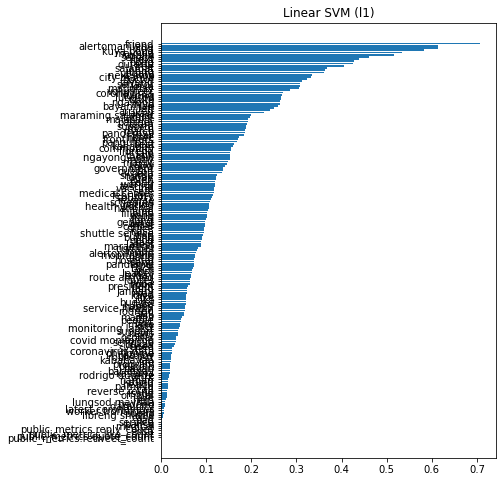

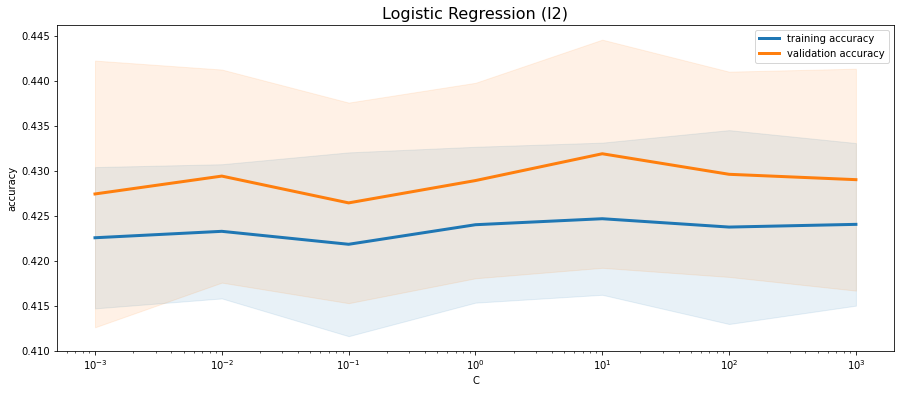

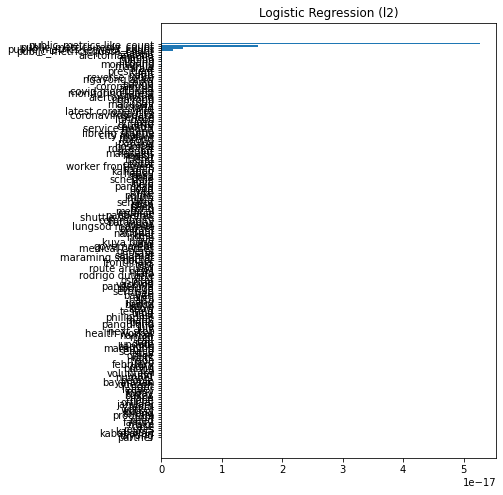

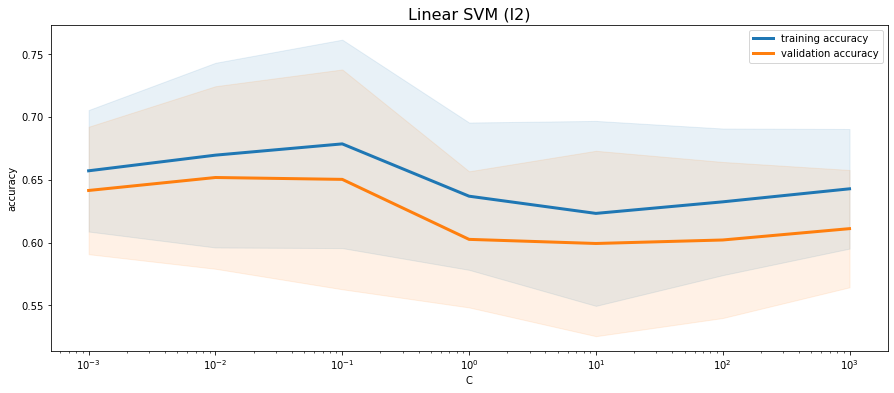

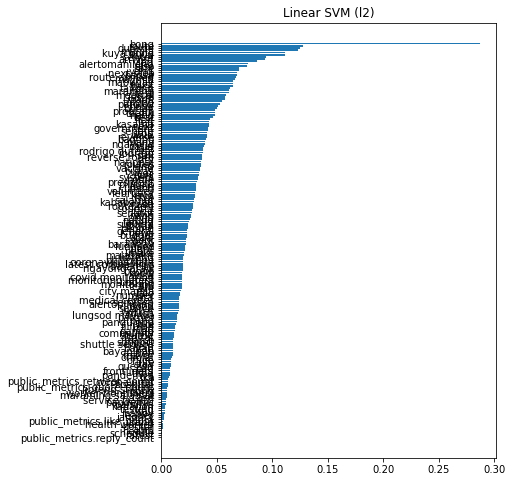

In [38]:
multi_class_engagement_model()

As seen in the results above, we can see that Gradient Boosing Classifier works best in terms of accuracy. However, because of the limitations of the current implementation of SHAP towards multi-class tree-based classification and for better interpretability through LIME, we opted to remove our engagement metrics as part of the features.